# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

In order to be able to identify and understand what are the key drivers for used car prices, we are going to work on the data of used car business which was previously collected and provided to us by a dataset (CVS Format). We are going to apply the data analysis techniques for getting the knowledge about the data atttributes and use the Machine Learning tools for the processing of the data.
The dataset contains different attributes of the sale of used cars like: the price, the location, color and engine features and many others.

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

1. Explore the dataset attributes to know about the data types
2. Plot the data to see their distribution
3. Identify missing data:
   - What attributes don't contain data.
   - Determine the amount of records per attribute with that condition.
   - Define how to deal with missing values: drop the records, replace the value, drop the column
4. Detect and remove the outliers for price attribute
5. Identify what are the categorical and ordinal features:
   - Identity unique values per attribute.
   - Apply the proper encoder so they can be used in the regression model.
6. Identify what attributes are not needed and remove them from dataset
8. Run the correlation to the target so we can identify what features have a strong positive correlation.

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [1]:
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge, LinearRegression, Ridge, Lasso
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, OneHotEncoder
from sklearn.compose import make_column_transformer, TransformedTargetRegressor
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from scipy import stats

from category_encoders import TargetEncoder

import seaborn as sns
import plotly.express as px

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import re

import warnings
warnings.filterwarnings("ignore")

In [117]:
pd.set_option("display.max_columns", None)
# In case you've downloaded this notebook from the Git repo, unzip vehicles.csv.zip first and put the csv file under data folder
df = pd.read_csv('data/vehicles.csv') 

In [3]:
df.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [5]:
# Use id as index.
# Id has not duplicated values so it's good for indexing.
df.set_index("id")

,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
id,,,,,,,,,,,,,,,,,
7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,1N4AA6AV6KC367801,fwd,NaN,sedan,NaN,wy
7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,7JR102FKXLG042696,fwd,NaN,sedan,red,wy
7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,1GYFZFR46LF088296,NaN,NaN,hatchback,white,wy


### Missing data

#### Identify the features with missing data and the percentage againts the total of records

In [6]:
def get_missing_value(df):
    mising_data_df = df.isnull().sum().reset_index().rename({"index":"feature", 0:"total"}, axis=1)
    mising_data_df["percent"] = (mising_data_df["total"]  * 100) / len(df)
    mising_data_df.sort_values(by="total", ascending=False, inplace=True)
    return mising_data_df
    

In [7]:

mising_data_df = get_missing_value(df)

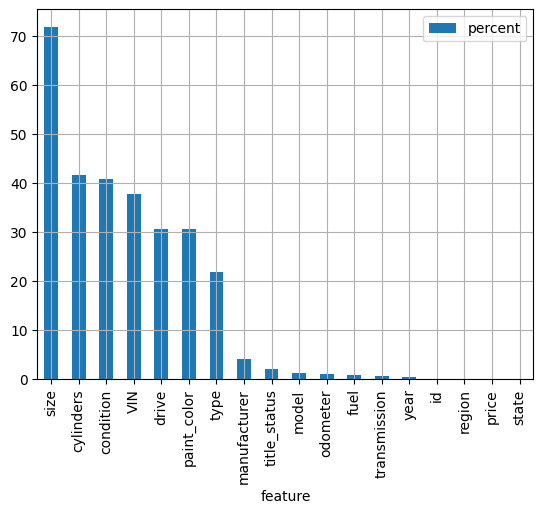

In [8]:
mising_data_df.plot(kind='bar', x='feature', y='percent')
plt.grid()
plt.show()

#### Cleaning the missing data

In [9]:
# Drop the missing records for features which have the 1 percent of missing data
clean_df = df
clean_df.dropna(subset=["odometer","fuel","transmission","year", "id", "region", "price"], inplace=True)

# Use the moda of each featute to fill the missing data for feature which have a lot of missing data
clean_df["size"].fillna(clean_df["size"].mode().to_string(), inplace=True)
clean_df["cylinders"].fillna(clean_df["cylinders"].mode().to_string(), inplace=True)
clean_df["condition"].fillna(clean_df["condition"].mode().to_string(), inplace=True)
clean_df["VIN"].fillna(clean_df["VIN"].mode().to_string(), inplace=True)
clean_df["drive"].fillna(clean_df["drive"].mode().to_string(), inplace=True)
clean_df["paint_color"].fillna(clean_df["paint_color"].mode().to_string(), inplace=True)
clean_df["type"].fillna(clean_df["type"].mode().to_string(), inplace=True)
clean_df["manufacturer"].fillna(clean_df["manufacturer"].mode().to_string(), inplace=True)
clean_df["title_status"].fillna(clean_df["title_status"].mode().to_string(), inplace=True)
clean_df["model"].fillna(clean_df["model"].mode().to_string(), inplace=True)

# Check for missing again
get_missing_value(clean_df)



,feature,total,percent
0,id,0,0.0
1,region,0,0.0
16,paint_color,0,0.0
15,type,0,0.0
14,size,0,0.0
13,drive,0,0.0
12,VIN,0,0.0
11,transmission,0,0.0
10,title_status,0,0.0
9,odometer,0,0.0


#### Review the outliers
Identify price outliers

In [10]:
#pip install matplotlib==3.7.3

[Text(0.5, 1.0, 'Distribution of Price')]

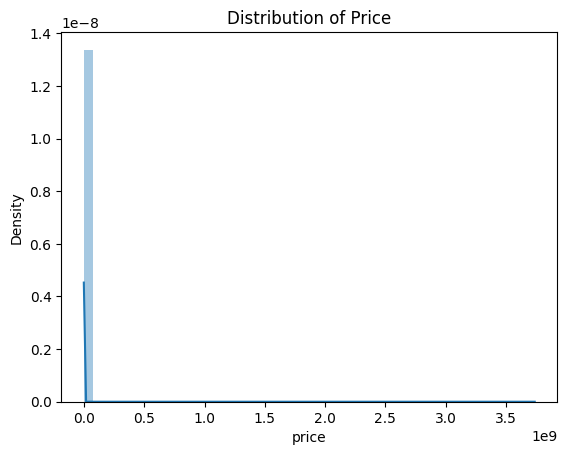

In [11]:
sns.distplot(clean_df['price']).set(title = "Distribution of Price")

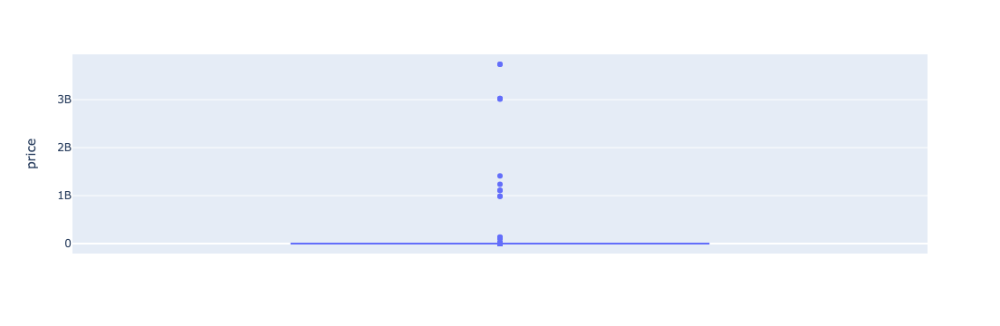

In [12]:
fig = px.box(clean_df, y="price")
fig.show()

The boxplot showed us there are records having huge prices also some have 0 price. 

In [13]:
def get_price_outliers(price_df, threshold=1.5):
    Q1 = price_df['price'].quantile(0.25)
    Q3 = price_df['price'].quantile(0.75)
    IQR = Q3 - Q1
    
    # identify outliers
    outliers = price_df[(price_df['price'] < Q1 - threshold * IQR) | (price_df['price'] > Q3 + threshold * IQR)]
    return outliers.sort_values(by='price', ascending=False)[["price"]]
    

In [14]:
#Identifying outliers
get_price_outliers(clean_df, 0)


,price
318592,3736928711
356716,3736928711
91576,3024942282
257840,3024942282
37410,3009548743
...,...
271849,0
376192,0
271847,0
271846,0


#### Filter df to leave the records which have prices > 200 and < 80000

In [15]:
clean_df = clean_df[(clean_df["price"]> 200) & (clean_df["price"] < 80000)]
clean_df.shape


(380613, 18)

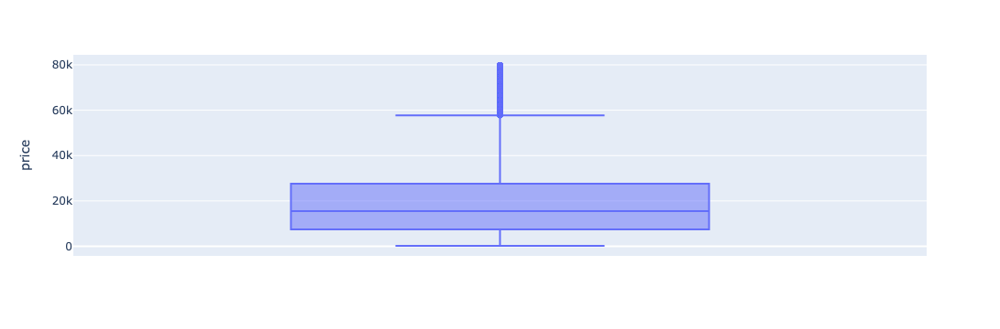

In [16]:
fig = px.box(clean_df, y="price")
fig.show()

[Text(0.5, 1.0, 'Distribution of Price')]

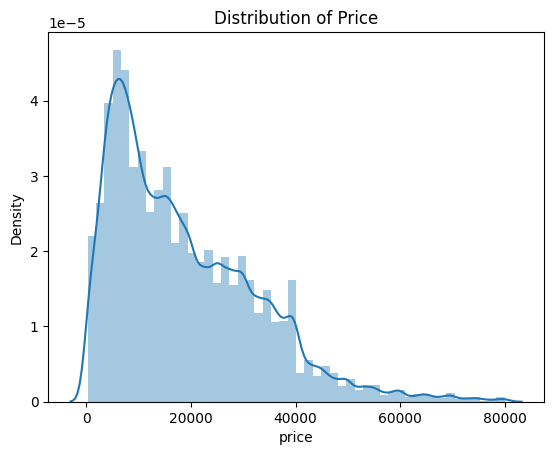

In [17]:
sns.distplot(clean_df['price']).set(title = "Distribution of Price")

#### Handling the categorical features
With the aim to run the correlation process and identify the strongest positive correlation with price:
- Identity unique values per attribute.
- Identify what features are Categorical
- Identify what features are Ordinal
- Apply the proper encoder

In [18]:
# Get the unique values of the string features 

In [19]:
# This function allows to get unique values per columns
def get_feature_unique_values(values_df, only_string):
    colList = values_df.dtypes.reset_index()
    # get the features with object type
    cols = colList
    if(only_string):
        cols = colList[colList[0] == 'object']
        
    col_unique_val_counter = []
    for colname in cols["index"]:
        col_unique_vals = values_df[colname].unique()
        print("--------------")
        print(colname, ", total unique values: ", len(col_unique_vals))
        print("--------------")    
        print(col_unique_vals)
        col_unique_val_counter.append([colname, len(col_unique_vals)])

    # show a sorted df with the unique values counting
    print(" ")
    print("----------------------------------------")
    print("--------Unique Values Summary-----------")
    print(pd.DataFrame(col_unique_val_counter, columns =["Feature", "Total"]).sort_values(by='Total', ascending=False))
    

In [20]:
# get unique values of the string features
get_feature_unique_values(clean_df, True)


--------------
region , total unique values:  404
--------------
['auburn' 'birmingham' 'dothan' 'florence / muscle shoals'
 'gadsden-anniston' 'huntsville / decatur' 'mobile' 'montgomery'
 'tuscaloosa' 'anchorage / mat-su' 'fairbanks' 'kenai peninsula'
 'southeast alaska' 'flagstaff / sedona' 'mohave county' 'phoenix'
 'prescott' 'show low' 'sierra vista' 'tucson' 'yuma' 'fayetteville'
 'fort smith' 'jonesboro' 'little rock' 'texarkana' 'bakersfield' 'chico'
 'fresno / madera' 'gold country' 'hanford-corcoran' 'humboldt county'
 'imperial county' 'inland empire' 'los angeles' 'mendocino county'
 'merced' 'modesto' 'monterey bay' 'orange county' 'palm springs'
 'redding' 'reno / tahoe' 'sacramento' 'san diego' 'san luis obispo'
 'santa barbara' 'santa maria' 'SF bay area' 'siskiyou county' 'stockton'
 'susanville' 'ventura county' 'visalia-tulare' 'yuba-sutter' 'boulder'
 'colorado springs' 'denver' 'eastern CO' 'fort collins / north CO'
 'high rockies' 'pueblo' 'western slope' 'easter

After reviewing the unique values, I found:
1. model: it could be a key feature for car selling but it has 26802 unique values, also, its values are messy, a cleaning text process is needed to get better info for it.
1. region: have also many unique values, also, for the location purposes the state could be enough so we're going to exclude it from dataset
2. VIN: has 114186 values, this is specific attribute of the car so I think it have not impact on the price.

The categorical feature we're going to use are: state, model, manufacturer, type, paint_color, cylinders, condition, title_status, fuel, size, drive, transmission


#### Adjusting the values of some categorical features
Some features have text values mixed with numerical values so it's needed put them all in the same terms


In [21]:
# Clean the model features, it has a lot records messy texts, we'll try to get the first 2 words

# Define a function to clean the model text
def clean_model_text(row):
    text = row["model"]
    manufacturer = row["manufacturer"] 
    # Split the text
    parts = re.split(r"[, \!?:]+", text)
    part_index = 0
    value =   parts[part_index]

    # Extract the potential model name (usually the first 2 words)
    if(value == manufacturer): 
        part_index += 1 
        value = parts[part_index]   

    #if(len(parts) > part_index+1):
    #    value += ' ' + parts[part_index+1]
        
    model_name = value.title()  # Capitalize the first letter
    return model_name

# Apply the cleaning function to the 'model' column
clean_df['model'] = clean_df.apply(clean_model_text, axis=1)


In [22]:
# Check the model unique values
get_feature_unique_values(clean_df[["model"]], True)

--------------
model , total unique values:  4126
--------------
['Sierra' 'Silverado' 'Tundra' ... 'Rx&' 'Ati' 'Gand']
 
----------------------------------------
--------Unique Values Summary-----------
  Feature  Total
0   model   4126


In [23]:
# Adjust the condition values ['good' 'excellent' 'fair' '0    0    6 cylinders' 'like new' 'new' 'salvage']
# Convert '0    0    6 cylinders' to other
# Convert '0    good' to goof 
clean_df["condition"].replace({"0    0    6 cylinders" : "other"}, inplace = True)
clean_df["condition"].replace({"0    good" : "good"}, inplace = True)


In [24]:
# Adjust the cylinders values ['8 cylinders' '6 cylinders' '0    6 cylinders' '4 cylinders' '5 cylinders' 'other' '3 cylinders' '10 cylinders' '12 cylinders']
# Convert '0    6 cylinders' to '6 cylinders'
clean_df["cylinders"].replace({"0    6 cylinders" : "6 cylinders"}, inplace = True)

# Then convert these values to ordinal
clean_df["cylinders"].replace({"8 cylinders" : 8, "6 cylinders" : 6, "0    6 cylinders" : 6, \
                               "5 cylinders" : 5, "4 cylinders" : 4, "10 cylinders" : 10, \
                               "3 cylinders" : 3, "12 cylinders" : 12, "other" : 6}, inplace = True)

In [25]:
# Adjust the title_status values ['clean' 'rebuilt' 'lien' '0    clean' 'salvage' 'missing' 'parts only']
# Convert '0    clean' to 'clean'
clean_df["title_status"].replace({"0    clean" : "clean"}, inplace = True)

In [26]:
# Adjust the drive values ['0    4wd' 'rwd' '4wd' 'fwd']
# Convert '0    4wd' to '4wd'
clean_df["drive"].replace({"0    4wd" : "4wd"}, inplace = True)

In [27]:
# Adjust the size values ['0    full-size' 'full-size' 'mid-size' 'compact' 'sub-compact']
# Convert '0    full-size' to 'full-size'
clean_df["size"].replace({"0    full-size" : "full-size"}, inplace = True)

In [28]:
# Adjust the type values ['pickup' 'truck' 'other' '0    sedan' 'coupe' 'SUV' 'hatchback'
#                         'mini-van' 'sedan' 'offroad' 'bus' 'van' 'convertible' 'wagon']
# Convert '0    sedan' to 'sedan'
clean_df["type"].replace({"0    sedan" : "sedan"}, inplace = True)

In [29]:
# Adjust the paint_color values ['white' 'blue' 'red' 'black' 'silver' 'grey' '0    white' 'brown'
#                                'yellow' 'orange' 'green' 'custom' 'purple']
# Convert '0    sedan' to 'sedan'
clean_df["paint_color"].replace({"0    white" : "white"}, inplace = True)

In [31]:
# get unique values per feature
get_feature_unique_values(clean_df, False)

--------------
id , total unique values:  380613
--------------
[7316814884 7316814758 7316814989 ... 7301591147 7301591140 7301591129]
--------------
region , total unique values:  404
--------------
['auburn' 'birmingham' 'dothan' 'florence / muscle shoals'
 'gadsden-anniston' 'huntsville / decatur' 'mobile' 'montgomery'
 'tuscaloosa' 'anchorage / mat-su' 'fairbanks' 'kenai peninsula'
 'southeast alaska' 'flagstaff / sedona' 'mohave county' 'phoenix'
 'prescott' 'show low' 'sierra vista' 'tucson' 'yuma' 'fayetteville'
 'fort smith' 'jonesboro' 'little rock' 'texarkana' 'bakersfield' 'chico'
 'fresno / madera' 'gold country' 'hanford-corcoran' 'humboldt county'
 'imperial county' 'inland empire' 'los angeles' 'mendocino county'
 'merced' 'modesto' 'monterey bay' 'orange county' 'palm springs'
 'redding' 'reno / tahoe' 'sacramento' 'san diego' 'san luis obispo'
 'santa barbara' 'santa maria' 'SF bay area' 'siskiyou county' 'stockton'
 'susanville' 'ventura county' 'visalia-tulare' 'yub

In [32]:
# First remove the unneeded features
clean_df.drop(["region", "VIN"], axis=1, inplace=True)

In [33]:
# Encode the categorial features and combine the result into the dataframe
# We are using TargetEncoder instead of OneHotEncoder, because OneHotEnconder creates a new column per value this dataset contains
# some categorical features having many values generating high dimensionality

cat_cols = ['manufacturer', 'model', 'type', 'paint_color', 'cylinders', 'condition', 'title_status', 'fuel', 'size', 'drive', 
            'transmission', 'state']

target_encoder = TargetEncoder()
enc_df = target_encoder.fit_transform(clean_df[cat_cols], clean_df["price"])

# combine and create a new df
# Remove the original categorical features
vehicle_df = clean_df.drop(cat_cols, axis=1)

enc_df.index = vehicle_df.index
vehicle_df = pd.concat([vehicle_df, enc_df], axis = 1).set_index("id")


In [34]:
print("enc_df.shape",enc_df.shape)
print("clean_df.shape",clean_df.shape)

enc_df.shape (380613, 12)
clean_df.shape (380613, 16)


In [35]:
# Review missing data after concatenating the encoded with the initial dataframe
get_missing_value(vehicle_df)

,feature,total,percent
0,price,0,0.0
1,year,0,0.0
2,odometer,0,0.0
3,manufacturer,0,0.0
4,model,0,0.0
5,type,0,0.0
6,paint_color,0,0.0
7,cylinders,0,0.0
8,condition,0,0.0
9,title_status,0,0.0


In [36]:
vehicle_df.head(5)

,price,year,odometer,manufacturer,model,type,paint_color,cylinders,condition,title_status,fuel,size,drive,transmission,state
id,,,,,,,,,,,,,,,
7316814884,33590,2014.0,57923.0,24705.940711,31192.716796,28304.508998,19259.137897,8,20288.565860,18949.52036,16852.71661,19742.56126,20799.194809,28251.121627,20834.934115
7316814758,22590,2010.0,71229.0,19782.254091,27303.216150,28304.508998,16984.918481,8,20288.565860,18949.52036,16852.71661,19742.56126,20799.194809,28251.121627,20834.934115
7316814989,39590,2020.0,19160.0,19782.254091,27303.216150,28304.508998,19264.984785,8,20288.565860,18949.52036,16852.71661,19742.56126,20799.194809,28251.121627,20834.934115
7316743432,30990,2017.0,41124.0,17223.907516,28008.486146,28304.508998,19264.984785,8,20288.565860,18949.52036,16852.71661,19742.56126,20799.194809,28251.121627,20834.934115
7316356412,15000,2013.0,128000.0,20852.505890,23610.552881,26791.215957,21537.405988,6,15351.049201,18949.52036,16852.71661,19742.56126,20544.767250,17105.411319,20834.934115


#### Reviewing the dataframe correlation with price
Once we have built the dataframe, we're going to rewiew the correlations and see how the features behave against the price.

In [37]:
corr_data = vehicle_df.corr()

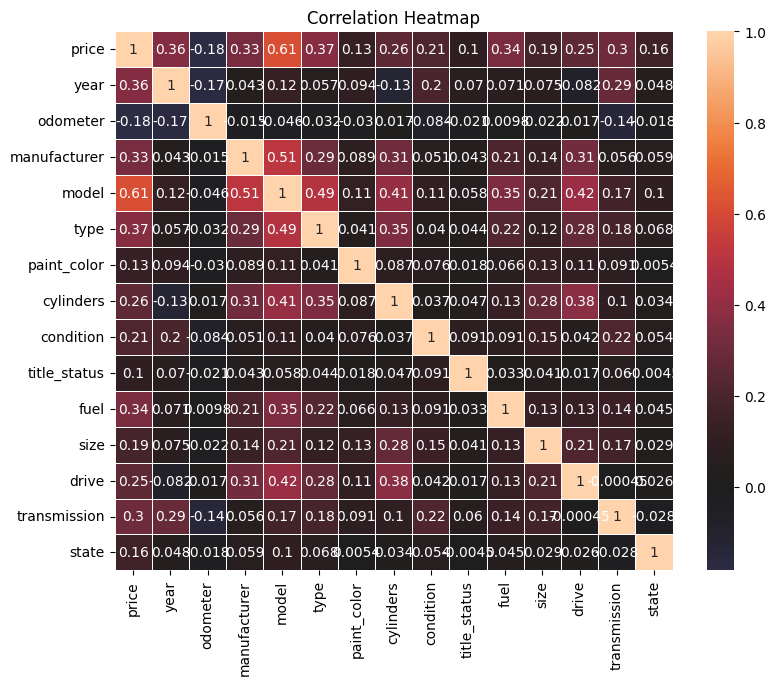

In [38]:
#correlation heatmap  
sns.cubehelix_palette(as_cmap=True)
f, ax = plt.subplots(figsize=(9, 7))
sns.heatmap(corr_data, center = 0, linewidth = .5, annot = True).set(title='Correlation Heatmap');

In [39]:
# Dataframe correlation with price and getting those which are greater than 0
price_corr_data = corr_data[['price']].sort_values(by='price', ascending=False)[1:].reset_index()

In [40]:
price_corr_data.head(30)

,index,price
0,model,0.611945
1,type,0.370723
2,year,0.360951
3,fuel,0.336564
4,manufacturer,0.333695
5,transmission,0.299869
6,cylinders,0.259705
7,drive,0.252599
8,condition,0.210172
9,size,0.185786


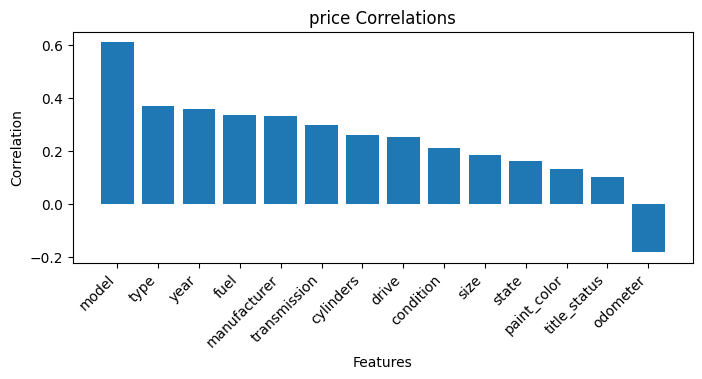

In [41]:
# Plot of the correlation with price
plt.figure(figsize=(8,3))
plt.bar(x=price_corr_data["index"], height=price_corr_data["price"], label='line 1')
plt.title("price Correlations")
plt.xlabel('Features')
plt.ylabel('Correlation')
plt.xticks(rotation=45, ha='right')
plt.show()

##### The correlation with price shows that the odometer has a negative correlation, that would explain that lower odometers have higher prices and vice versa. The other features have positive correlation with price.

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

#### Getting the training and test sets

In [42]:
vehicle_df["price"] = np.log(vehicle_df["price"])

In [43]:
# Remove infinite valyes caused by the log over the price.
vehicle_df = vehicle_df[vehicle_df['price'] != -float('inf')]

In [44]:
# get the training data
X = vehicle_df.drop("price", axis=1)
y = vehicle_df["price"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

#### Runnning regression models 
Next we're going to run some regression model to evaluate their performance and see what feature have the best coefficients.

In [45]:
# Create a list to store the scores
model_scores = []

#### Simple Linear Regression

In [46]:
lin_reg = LinearRegression(fit_intercept = True).fit(X_train, y_train)

# Calculate MSE and store the result along the other results
train_preds = lin_reg.predict(X_train)
test_preds = lin_reg.predict(X_test)
lin_reg_train_mse = mean_squared_error(train_preds, y_train)
lin_reg_test_mse = mean_squared_error(test_preds, y_test)
lin_regtrain_r2 = r2_score(y_train, train_preds)
lin_regtest_r2 = r2_score(y_test, test_preds)

model_scores.append({"Model":"Linear Regression", "Train MSE": lin_reg_train_mse, "Test MSE":  lin_reg_test_mse, "Train R2": lin_regtrain_r2, "Test R2":  lin_regtest_r2, "Addition Info":""})

#### Simple Cross Validation with Linear Regression and PolynomialFeatures
Run a LinearRegresion 3 times to get the degree

In [47]:
# Function thet allows to do a Linear regression 3 times
def simple_cross_validation(X_train, y_train, X_test, y_test):
    best_pipe = None
    best_mse = np.inf

    for degree in range(1, 4):
        pipe = Pipeline([
            ("transform", PolynomialFeatures(degree = degree, include_bias = False)),
            ("scaler", StandardScaler()),
            ("regression", LinearRegression())
        ])

        pipe.fit(X_train, y_train)
        
        test_mse = mean_squared_error(pipe.predict(X_test), y_test)

        if test_mse < best_mse:
            best_mse = test_mse
            best_pipe = pipe
    return best_pipe

In [48]:
# Run the cross validation
lr_model = simple_cross_validation(X_train, y_train, X_test, y_test)


In [49]:
print("transform__degree", lr_model.get_params()["transform__degree"])

transform__degree 3


In [50]:
# Calculate MSE and store the result along the other results
train_preds = lr_model.predict(X_train)
test_preds = lr_model.predict(X_test)
lr_train_mse = mean_squared_error(y_train, train_preds)
lr_test_mse = mean_squared_error(y_test, test_preds)
lr_train_r2 = r2_score(y_train, train_preds)
lr_test_r2 = r2_score(y_test, test_preds)

model_scores.append({"Model":"Simple Cross Val + Linear Regression", "Train MSE": lr_train_mse, "Test MSE":  lr_test_mse, "Train R2":lr_train_r2, "Test R2": lr_test_r2, "Addition Info": "Degree: " + str(lr_model.get_params()["transform__degree"])})

In [51]:
# Review Features coefficients
lr_features = lr_model["transform"].get_feature_names_out()
lr_coef = lr_model["regression"].coef_

lasso_coef_df = pd.DataFrame(list(zip(lr_features, lr_coef)), columns=["Feature", "Coef"]).sort_values(by="Coef", ascending=False)
lasso_coef_df

,Feature,Coef
116,transmission^2,2.091163e+11
11,drive,3.753238e+09
669,drive^3,3.367986e+09
119,year^3,1.913904e+03
0,year,1.784540e+03
...,...,...
109,size^2,-8.161102e+02
14,year^2,-3.697807e+03
113,drive^2,-7.121087e+09
12,transmission,-8.866967e+10


#### Ridge Regression
This model allows to get the features coefficients of the correlation with the target

In [52]:
# Ridge
ridge = Ridge().fit(X_train, y_train)

# Calculate MSE and store the result along the other results
train_preds = ridge.predict(X_train)
test_preds = ridge.predict(X_test)
ridge_train_mse = mean_squared_error(y_train, train_preds)
ridge_test_mse = mean_squared_error(y_test, test_preds)
ridge_train_r2 = r2_score(y_train, train_preds)
ridge_test_r2 = r2_score(y_test, test_preds)

model_scores.append({"Model":"Ridge", "Train MSE": ridge_train_mse, "Test MSE":  ridge_test_mse, "Train R2":ridge_train_r2, "Test R2": ridge_test_r2, "Addition Info":""})

In [53]:
# review the coefficients
ridge_feature_coefs = pd.DataFrame(list(zip(X_train.columns, ridge.coef_)), 
                                   columns=["Feature", "Coef"]).sort_values(by="Coef", ascending=False)
ridge_feature_coefs

,Feature,Coef
6,cylinders,3.843534e-02
0,year,2.301556e-02
3,model,4.252460e-05
8,title_status,3.094980e-05
12,transmission,2.863142e-05
7,condition,2.797233e-05
13,state,2.755374e-05
9,fuel,1.262068e-05
4,type,9.848591e-06
5,paint_color,7.589548e-06


#### Ridge Regression Model with GridSearchCV
GridSearchCV is implemented with 3-fold cross validation

In [54]:
# dictionary of alpha values for GridSearchCV
alphas = {"ridge__alpha" : [0.0001, 0.001, 0.01, 0.1, 1.0, 10.0]}

In [55]:
#building the ridge model 
ridge_pipe = Pipeline([
    ("transform", PolynomialFeatures(degree = 3, include_bias = False)),
    ("scale", StandardScaler()),
    ("ridge", Ridge())
])

#GridSearchCV to find optimal alpha hyperparameter 
ridge_grid = GridSearchCV(estimator = ridge_pipe,
                            param_grid = alphas,
                            scoring = "neg_mean_squared_error",
                            cv = 3)   

In [56]:
ridge_grid.fit(X_train, y_train) 

best_estimator = ridge_grid.best_estimator_
best_model = best_estimator.named_steps['ridge']

In [57]:
# Calculate MSE and store the result along the other results
train_preds = ridge_grid.predict(X_train)
test_preds = ridge_grid.predict(X_test)
grid_ridge_train_mse = mean_squared_error(y_train, train_preds)
grid_ridge_test_mse = mean_squared_error(y_test, test_preds)
grid_ridge_train_r2 = r2_score(y_train, train_preds)
grid_ridge_test_r2 = r2_score(y_test, test_preds)

model_scores.append({"Model":"Grid Search + Ridge", "Train MSE": grid_ridge_train_mse, "Test MSE":  grid_ridge_test_mse, "Train R2": grid_ridge_train_r2, "Test R2": grid_ridge_test_r2,  "Addition Info":"Alpha: " + str(ridge_grid.best_params_["ridge__alpha"])})

In [58]:
# Review the coefficients
feature_names = best_estimator.named_steps['transform'].get_feature_names_out()
coefs = best_model.coef_
feature_coef_df = pd.DataFrame(list(zip(feature_names, coefs)), columns=["Feature", "Coef"]).sort_values(by="Coef", ascending=False)
feature_coef_df

,Feature,Coef
119,year^3,9.773950
11,drive,1.567271
28,odometer^2,1.532646
514,paint_color^3,1.351201
126,year^2 condition,1.297406
...,...,...
97,condition state,-1.200598
91,condition^2,-1.232215
224,odometer^3,-1.328598
130,year^2 drive,-1.340782


In [59]:
# Ridge best alpha and score
print("ridge_grid.best_params_", ridge_grid.best_params_["ridge__alpha"])
print("ridge_grid.best_score_", ridge_grid.best_score_)

ridge_grid.best_params_ 10.0
ridge_grid.best_score_ -0.445693672008038


#### Sequential Feature Selection with Lasso Regression
Use a cross-validated with 5-fold cross validation

In [60]:
sf_selector = SequentialFeatureSelector(estimator = Lasso(),
                                scoring = "neg_mean_squared_error",
                                cv = 5,
                                n_features_to_select = 10).fit(X_train, y_train)

In [61]:
# Get the best estimator to the feature coefficients
sf_selector.estimator.fit(X_train, y_train)

# Review the coefficients
sf_selector.estimator.coef_
coefificients = pd.DataFrame(list(zip(X_train.columns, sf_selector.estimator.coef_)), columns=["Feature", "Coef"]).sort_values(by="Coef", ascending=False)
coefificients.query("Feature in@feature_names")

,Feature,Coef
0,year,9.498750e-03
3,model,4.523627e-05
12,transmission,3.549313e-05
8,title_status,3.492546e-05
7,condition,3.280558e-05
13,state,2.937144e-05
9,fuel,1.239243e-05
5,paint_color,1.186208e-05
4,type,1.090533e-05
2,manufacturer,3.685870e-06


In [62]:
# Calculate MSE and store the result along the other results
train_preds = sf_selector.estimator.predict(X_train)
test_preds = sf_selector.estimator.predict(X_test)
seq_train_mse = mean_squared_error(y_train, train_preds)
seq_test_mse = mean_squared_error(y_test, test_preds)
seq_train_r2 = r2_score(y_train, train_preds)
seq_test_r2 = r2_score(y_test, test_preds)

model_scores.append({"Model":"Seq Feature + Lasso", "Train MSE": seq_train_mse, "Test MSE":  seq_test_mse, "Train R2": seq_train_r2, "Test R2": seq_test_r2, "Addition Info":""})

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

#### Review best model
The Simple Cross Val + Linear Regression and Grid Search + Ridge got the best MSE and R2 scores,the next list shows the results.

According to that, we are going to run the Permutation importances for both of the models and see how they behave.

In [63]:
# Model Scores
model_scores_df = pd.DataFrame(model_scores).set_index("Model")
model_scores_df.sort_values(by='Test MSE')

,Train MSE,Test MSE,Train R2,Test R2,Addition Info
Model,,,,,
Simple Cross Val + Linear Regression,0.406620,0.421417,0.571186,0.558565,Degree: 3
Grid Search + Ridge,0.427700,0.436750,0.548956,0.542503,Alpha: 10.0
Ridge,0.565257,0.568998,0.403891,0.403973,
Linear Regression,0.565257,0.568998,0.403891,0.403973,
Seq Feature + Lasso,0.579393,0.582883,0.388983,0.389429,


#### Permutation importance with Ridge

In [64]:
# Ridge Model
#per_ridge_model = Ridge(alpha=0.0001).fit(X_train, y_train)
#per_ridge_score = per_ridge_model.score(X_test, y_test)
#print("per_ridge_score", per_ridge_score)

# ridge_grid

ridge_per = permutation_importance(ridge_grid, X_test, y_test, n_repeats=30, random_state=42)
data = []
for i in ridge_per.importances_mean.argsort()[::-1]:
    if ridge_per.importances_mean[i] - 2 * ridge_per.importances_std[i] > 0:
        data.append({"feature": X_train.columns[i], "importances_mean": f"{ridge_per.importances_mean[i]:.3f}", "importances_std": f" +/- {ridge_per.importances_std[i]:.3f}"})
        
importance_df = pd.DataFrame(data).sort_values(by='importances_mean', ascending=False)
importance_df.set_index('feature')

,importances_mean,importances_std
feature,,
year,0.158,+/- 0.001
model,0.148,+/- 0.002
odometer,0.114,+/- 0.005
condition,0.049,+/- 0.001
cylinders,0.041,+/- 0.001
fuel,0.034,+/- 0.004
transmission,0.014,+/- 0.001
drive,0.014,+/- 0.001
manufacturer,0.011,+/- 0.002


#### Permutation importance with Linear Regression

In [66]:
# Ridge Model
#per_linref_model = LinearRegression().fit(X_train, y_train)
#per_linref_score = per_linref_model.score(X_test, y_test)
#print("per_linref_score", per_linref_score)
#lr_model["regression"]

linreg_per = permutation_importance(lr_model, X_test, y_test, n_repeats=30, random_state=42)
data = []
for i in linreg_per.importances_mean.argsort()[::-1]:
    if linreg_per.importances_mean[i] - 2 * linreg_per.importances_std[i] > 0:
        data.append({"feature": X_train.columns[i], "importances_mean": f"{linreg_per.importances_mean[i]:.3f}", "importances_std": f" +/- {linreg_per.importances_std[i]:.3f}"})
        
importance_df = pd.DataFrame(data).sort_values(by='importances_mean', ascending=False)
importance_df.set_index('feature')

,importances_mean,importances_std
feature,,
year,0.281,+/- 0.003
model,0.139,+/- 0.003
condition,0.058,+/- 0.001
cylinders,0.056,+/- 0.002
odometer,0.053,+/- 0.004
fuel,0.041,+/- 0.003
transmission,0.021,+/- 0.001
manufacturer,0.020,+/- 0.004
drive,0.019,+/- 0.007


#### The Permutation importances shows that year, model, condition, cylinders and odometer are the top five of features.

1. The result shows features which have impact on the price: year, model, condition, cylinders and odometer.
2. Some of these features where in the coefficients of the models. It's interesting to see the odemeter have negative coefficient in the model result and also, negative correlation with price but the permutation importances shows the odometer in the top five and the explanation could be at lower odometer higher price.
3. Because we use TargetEnconder to deal with the categorical features avoiding the high multidimensionality, we need to dig in them for getting more details, for example: what are the especific models getting the better prices.
4. 

### Analysis of each one of the top five features

#### Review the Correlation of top features and price

In [67]:
# Create a dataframe with the encoded top features and price
top_features_enc_df = vehicle_df[["year", "model", "condition", "cylinders" , "odometer", "price"]]

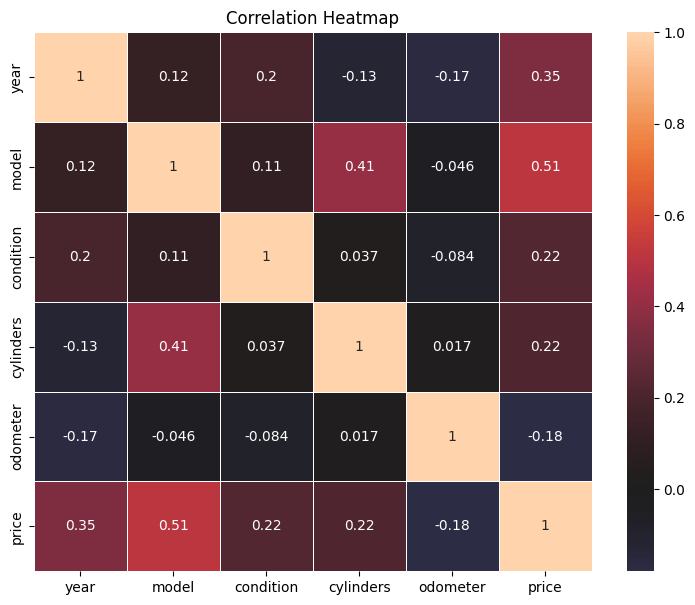

In [68]:
sns.cubehelix_palette(as_cmap=True)
f, ax = plt.subplots(figsize=(9, 7))
sns.heatmap(top_features_enc_df.corr(), center = 0, linewidth = .5, annot = True).set(title='Correlation Heatmap');

In [69]:
# Create a dataframe with clean info for the top features and price. The manufacturer was included to give more contex to model names
top_features_df = clean_df[["year", "model", "condition", "cylinders" , "odometer", "price", "manufacturer"]]
# Capitalize column names to use then in next plots
top_features_df.columns = [i.title() for i in top_features_df.columns]

#### Grouping the price by bins: low, medium and High, they will help us for rewiewing the behavior of the top features against the price

In [70]:
# binning- grouping values 
price_bins = np.linspace(min(top_features_df['Price']), max(top_features_df['Price']), 4)  
group_names = ['Low', 'Medium', 'High'] 
top_features_df['Price-Binned'] = pd.cut(top_features_df['Price'], price_bins,  
                              labels = group_names,  
                              include_lowest = True) 

In [71]:
price_binned = top_features_df.groupby(["Price-Binned"])["Price"].count() / len(top_features_df) * 100
price_binned = price_binned.reset_index().rename(columns={"Price": "Percent"})

# Show the min and max prices per category
pd.concat([top_features_df.groupby(["Price-Binned"])["Price"].min().reset_index(), 
           top_features_df.groupby(["Price-Binned"])["Price"].max().reset_index()],
           axis = 1).set_index("Price-Binned")

,Price,Price
Price-Binned,,
"(Low, Low)",201,26800
"(Medium, Medium)",26814,53337
"(High, High)",53414,79999


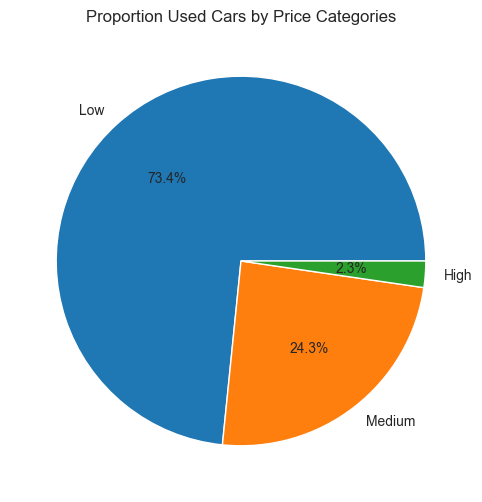

In [72]:
sns.set_style("whitegrid")
plt.figure(figsize=(6,6))
plt.pie(price_binned['Percent'], labels = price_binned["Price-Binned"], autopct='%1.1f%%')
plt.title('Proportion Used Cars by Price Categories')
plt.show()

#### Grouping the car year by bins

1. Most Recent (0-3 years old): These are late-model cars with the latest features and technologies. They typically command higher prices due to their near-new condition.
2. Recent (3-5 years old): Still considered very relevant and well-equipped, these cars offer a good balance between features, price, and depreciation.
3. Slightly Older Used Cars (5-10 years old): These become more affordable options while still offering modern features and reliability. They might be a good choice for budget-conscious buyers.
4. Older: more than 10 years

Note: This categories were gotten by asking Gemini.

In [107]:
# binning - grouping the year
max_year = max(top_features_df['Year'])
year_bins = [1900, max_year - 11 , max_year- 5, max_year - 3, max_year]

group_names = ['Older', 'Slightly Older', 'Recent', 'Most Recent'] 
top_features_df['Year-Binned'] = pd.cut(top_features_df['Year'], year_bins,  
                              labels = group_names,  
                              include_lowest = True) 

year_binned = top_features_df.groupby(["Year-Binned"])["Year"].count() / len(top_features_df) * 100
year_binned = year_binned.reset_index().rename(columns={"Year": "Percent"})

# Show the min and max prices per category
pd.concat([top_features_df.groupby(["Year-Binned"])["Year"].min().reset_index(), 
           top_features_df.groupby(["Year-Binned"])["Year"].max().reset_index()],
           axis = 1).set_index("Year-Binned")

,Year,Year
Year-Binned,,
"(Older, Older)",1900.0,2011.0
"(Slightly Older, Slightly Older)",2012.0,2017.0
"(Recent, Recent)",2018.0,2019.0
"(Most Recent, Most Recent)",2020.0,2022.0


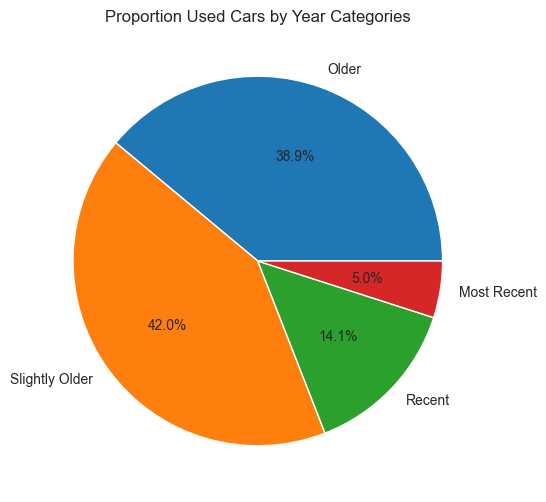

In [106]:

sns.set_style("whitegrid")
plt.figure(figsize=(6,6))
plt.pie(year_binned['Percent'], labels = year_binned["Year-Binned"], autopct='%1.1f%%')
plt.title('Proportion Used Cars by Year Categories')
plt.show()

#### Review the Year

1. Review how the car years are distributed by the Price Categories

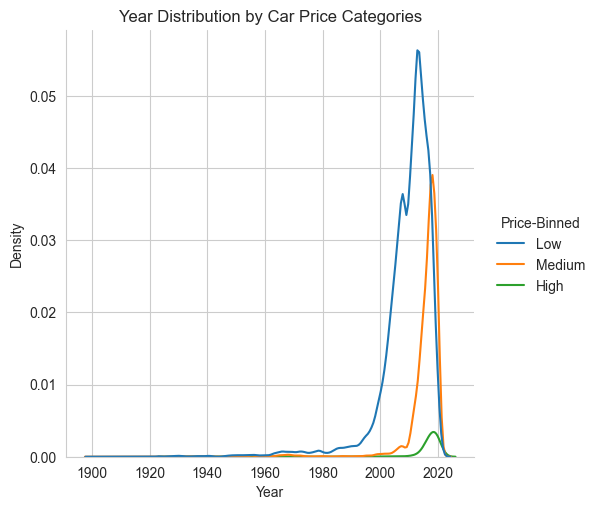

In [75]:
plot = sns.displot(data = top_features_df, x ="Year", kind = "kde", hue="Price-Binned")
plot.set(title='Year Distribution by Car Price Categories')

This plot show us how the car year impact on the price, the newest cars got the higher prices but it's important to note the high price group has fewer cars(2.3 %) than low (24.3%) and medium (73.4%) price groups

2. Let's eview how the prices are distributed by year categories

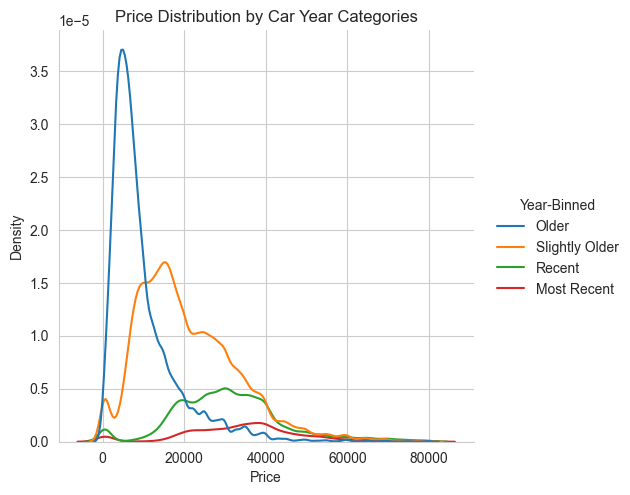

In [76]:
plot = sns.displot(data = top_features_df, x ="Price", kind = "kde", hue="Year-Binned")
plot.set(title='Price Distribution by Car Year Categories')

This plot show us that Recent and Most Recent cars groups have less than 19% % of the total vehicles, their prices are mostly medium with some outliers in the low and high price categories

#### Review the Model

1. Let's identify how many cars by model. Note: there are lot of models so we need to identify the top ones.

In [77]:
# Concat the manufacturer and model texts
top_features_df["Brand-Model"] = (top_features_df["Manufacturer"] + "-"+ top_features_df["Model"]).str.title()

# Get top models based on the car counting per model > 2000
pop_models_df = top_features_df["Brand-Model"].value_counts(ascending = False).to_frame().reset_index()
pop_models_df = pop_models_df[pop_models_df["count"] > 2000]
pop_models_df.head()

,Brand-Model,count
0,Chevrolet-Silverado,15022
1,Ford-F-150,8838
2,Ram-1500,8032
3,Gmc-Sierra,7446
4,Jeep-Wrangler,7133


In [78]:
#array of most popular models
model_list = pop_models_df["Brand-Model"].unique()

#df with only records where model is in top_12
pop_models = top_features_df["Brand-Model"].isin(model_list)
topmodel_df = top_features_df[pop_models]
print(len(model_list))
topmodel_df.head()

45


,Year,Model,Condition,Cylinders,Odometer,Price,Manufacturer,Price-Binned,Year-Binned,Brand-Model
27,2014.0,Sierra,good,8,57923.0,33590,gmc,Medium,Slightly Older,Gmc-Sierra
28,2010.0,Silverado,good,8,71229.0,22590,chevrolet,Low,Older,Chevrolet-Silverado
29,2020.0,Silverado,good,8,19160.0,39590,chevrolet,Medium,Most Recent,Chevrolet-Silverado
30,2017.0,Tundra,good,8,41124.0,30990,toyota,Medium,Slightly Older,Toyota-Tundra
31,2013.0,F-150,excellent,6,128000.0,15000,ford,Low,Slightly Older,Ford-F-150


2. Review the distribution of models by Price Categories

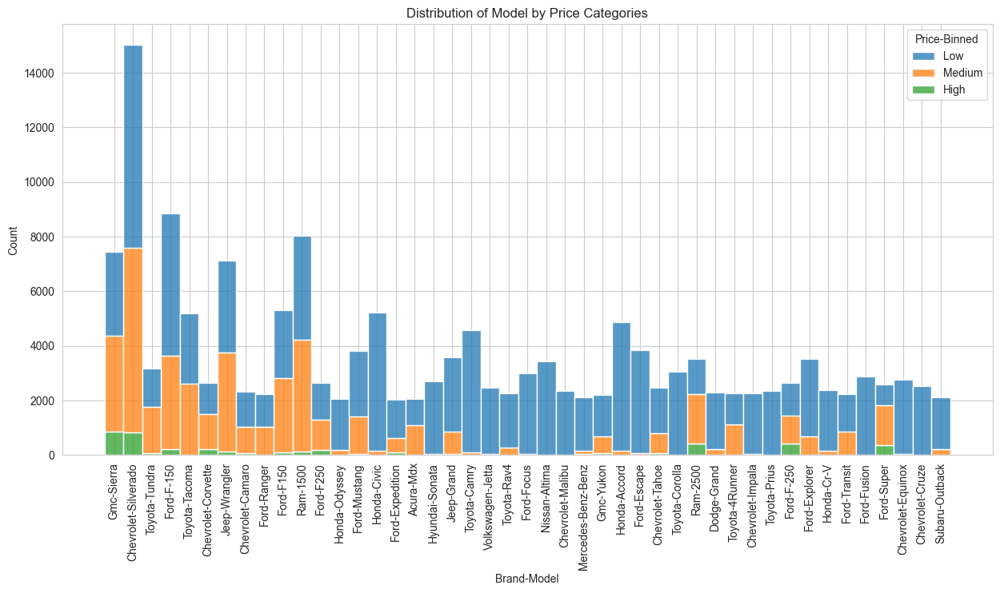

In [97]:
#list_prices = ['High', 'Medium']
plt.figure(figsize = (15, 7))
sns.histplot(topmodel_df, x = "Brand-Model", hue = "Price-Binned", multiple = "stack").set(title = "Distribution of Model by Price Categories")
#sns.histplot(topmodel_df[topmodel_df["Price-Binned"].isin(list_prices)], x = "Brand-Model", hue = "Price-Binned", multiple = "stack").set(title = "Distribution of Model Colored by Price")
plt.xticks(rotation = 90)
plt.show()

- Most of the models have a low price
- There are some models which have the medium and high prices

3. Review the distributtion of models by Year Categories

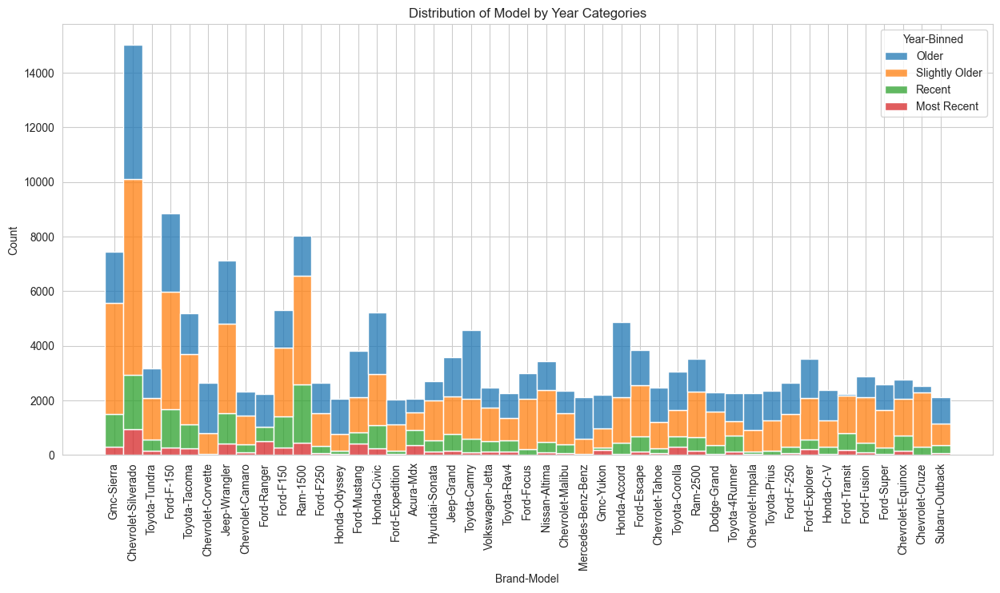

In [80]:
plt.figure(figsize = (15, 7))
sns.histplot(topmodel_df, x = "Brand-Model", hue = "Year-Binned", multiple = "stack").set(title = "Distribution of Model by Year Categories")
plt.xticks(rotation = 90)
plt.show()

1. Most of the models have old cars


#### Review odometer

1. Let's review the distribution of the odometer

[Text(0.5, 1.0, 'Distribution of Odometer')]

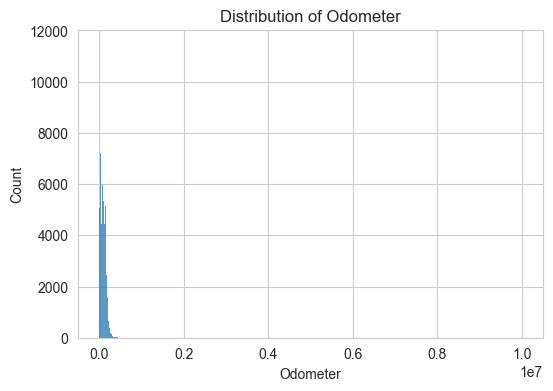

In [81]:
plt.figure(figsize = (6, 4))
sns.histplot(top_features_df, x = "Odometer").set(title = "Distribution of Odometer")

2. Let's how the odometer is distributed by bins

1. Low Mileage (Under 30,000 miles):

These cars are considered lightly used and likely have minimal wear and tear.
They might be well-maintained and command a premium price due to their near-new condition.
Ideal for buyers seeking a car with minimal prior usage.

2. Average Mileage (30,000 - 75,000 miles):

This falls within the typical range for used cars and suggests moderate use.
These cars are likely to have undergone routine maintenance and are a good balance between affordability and condition.
They are a popular option for many used car buyers.

3. High Mileage (75,000 - 100,000 miles):

Cars in this range have seen more use, and potential buyers should be more attentive to maintenance history and overall condition.
Depending on the car's age and how well it was maintained, it could still be a reliable option.
These cars tend to be more affordable than lower mileage counterparts.
    
4. Very High Mileage (Over 100,000 miles):

Cars with extremely high mileage have significant wear and tear and might require more frequent repairs.
Their value is considerably lower than cars in other categories.
Buyers should carefully inspect these cars and consider their budget for potential maintenance needs.

Note: This categories were gotten by asking Gemini.

In [82]:
max_odometer = max(top_features_df['Odometer'])
odometer_bins = [0, 30000, 75000, 100000, max_odometer] #np.linspace(min(top_features_df['Odometer']), max(top_features_df['Odometer']), 10)  
group_names = ["Low", "Average", "High", "Very High" ] 
top_features_df['Odometer-Binned'] = pd.cut(top_features_df['Odometer'], odometer_bins,  
                              labels = group_names,  
                              include_lowest = True) 


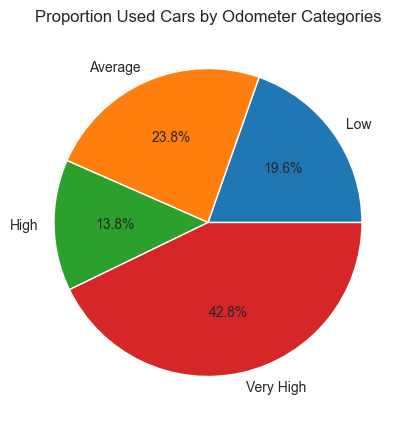

In [83]:
odometer_binned = top_features_df.groupby(["Odometer-Binned"])["Odometer"].count() / len(top_features_df) * 100
odometer_binned = odometer_binned.reset_index().rename(columns={"Odometer": "Percent"})
sns.set_style("whitegrid")
plt.figure(figsize=(6,5))
plt.pie(odometer_binned['Percent'], labels = odometer_binned["Odometer-Binned"], autopct='%1.1f%%')
plt.title('Proportion Used Cars by Odometer Categories')
plt.show()

In [84]:
pd.concat([top_features_df.groupby(["Odometer-Binned"])["Odometer"].min().reset_index(), 
           top_features_df.groupby(["Odometer-Binned"])["Odometer"].max().reset_index()],
           axis = 1).set_index("Odometer-Binned")

,Odometer,Odometer
Odometer-Binned,,
"(Low, Low)",0.0,30000.0
"(Average, Average)",30001.0,75000.0
"(High, High)",75001.0,100000.0
"(Very High, Very High)",100001.0,10000000.0


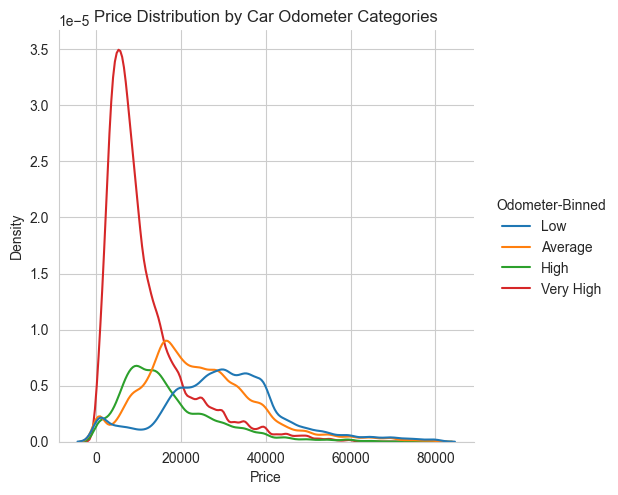

In [85]:
plot = sns.displot(data = top_features_df, x ="Price", kind = "kde", hue="Odometer-Binned")
plot.set(title='Price Distribution by Car Odometer Categories')

- The correlation showed us Odometer has a negative correlation with price, this plot show us the better prices are for vehicles with lower odometer and vice-versa, alhought there are some exceptions indicanting the price depends on other features too.  

#### Review the condtion

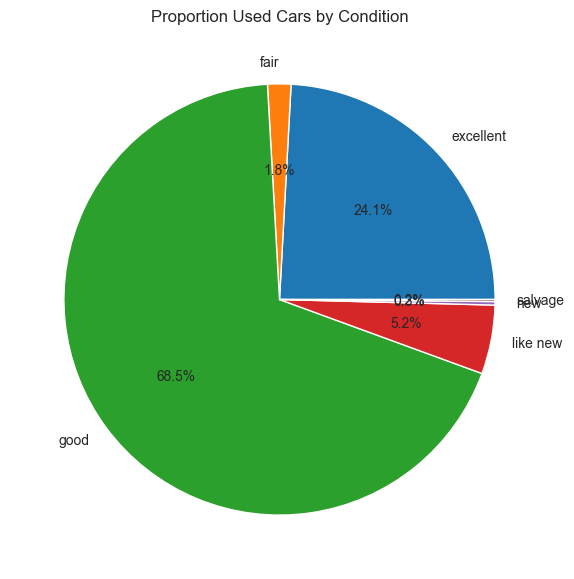

In [92]:
condition = top_features_df.groupby(["Condition"])["Price"].count() / len(top_features_df) * 100
condition = condition.reset_index().rename(columns={"Price": "Percent"})
sns.set_style("whitegrid")
plt.figure(figsize=(10,7))
plt.pie(condition['Percent'], labels = condition["Condition"], autopct='%1.1f%%')
plt.title('Proportion Used Cars by Condition')
plt.show()

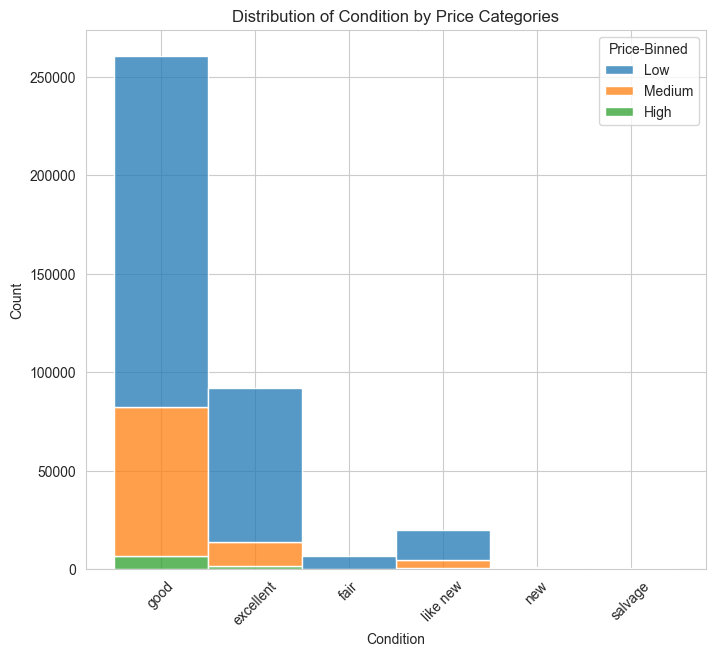

In [86]:
plt.figure(figsize = (8, 7))
sns.histplot(top_features_df, x = "Condition", hue = "Price-Binned", multiple = "stack").set(title = "Distribution of Condition by Price Categories")
plt.xticks(rotation = 45)
plt.show()

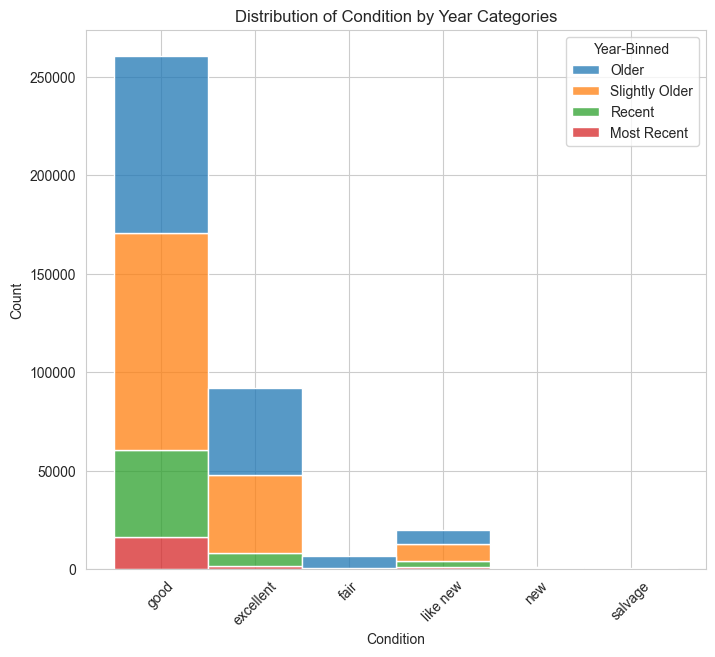

In [93]:
plt.figure(figsize = (8, 7))
sns.histplot(top_features_df, x = "Condition", hue = "Year-Binned", multiple = "stack").set(title = "Distribution of Condition by Year Categories")
plt.xticks(rotation = 45)
plt.show()

- Used cars in good conditions have the better prices, most of the used cars have good condition 

#### Review the Cylinders


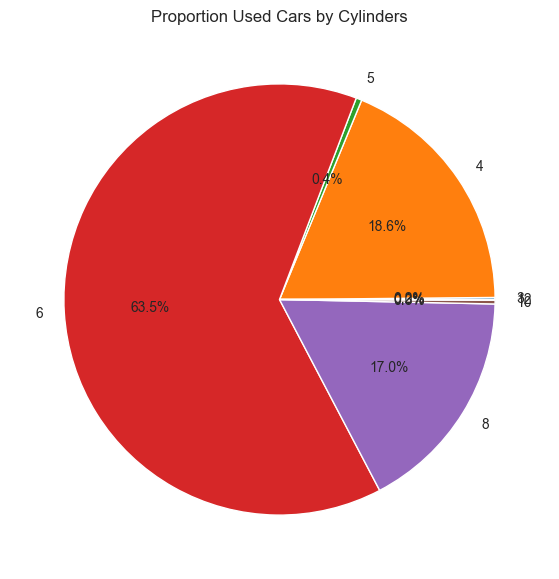

In [506]:
cylinders = top_features_df.groupby(["Cylinders"])["Price"].count() / len(top_features_df) * 100
cylinders = cylinders.reset_index().rename(columns={"Price": "Percent"})
sns.set_style("whitegrid")
plt.figure(figsize=(10,7))
plt.pie(cylinders['Percent'], labels = cylinders["Cylinders"], autopct='%1.1f%%')
plt.title('Proportion Used Cars by Cylinders')
plt.show()

In [507]:
cylinders

,Cylinders,Percent
0,3,0.152648
1,4,18.625480
2,5,0.429045
3,6,63.485220
4,8,16.975773
5,10,0.290321
6,12,0.041512


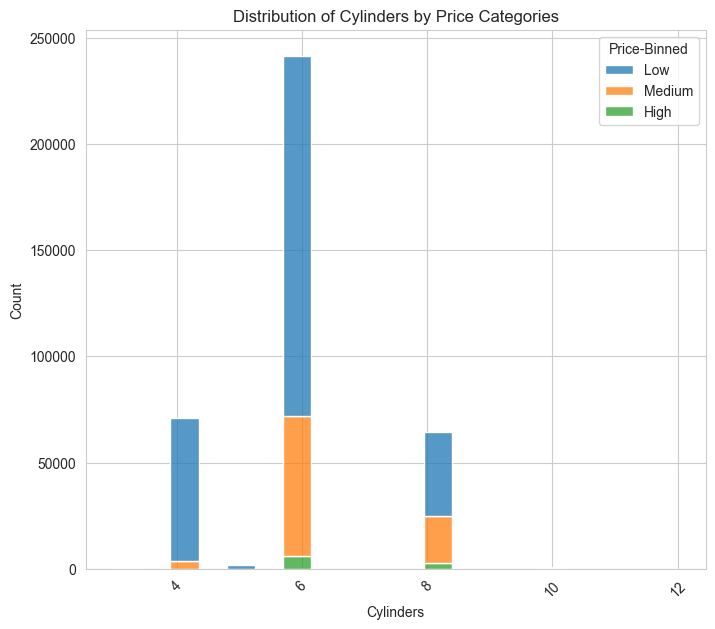

In [499]:
plt.figure(figsize = (8, 7))
sns.histplot(top_features_df, x = "Cylinders", hue = "Price-Binned", multiple = "stack").set(title = "Distribution of Cylinders by Price Categories")
plt.xticks(rotation = 45)
plt.show()

- Used cars with 6 and 8 cylinders have the better prices
- Most of the used cars have 6 and 8 cylinders

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

### Conclusions
After analysing the provided data and applying the Machine Learning tools for price prediction we found there are top five car features which have a clear impact on the price. 
Each Car Dealer can use these features to tune their car inventory for getting better sales and profit, so depending on their target customers:
1. Some car dealers could be interested in Higher prices only, so they might reduce their inventory with recognized brand, in good condition, most recent models, and low odometer.
2. Some car dealers could be interested in the Medium Prices and Lower prices and rapid sales, so they might increase their inventory with more used cars which be slighty older cars , in not so good conditions and average and high odometer

Next is the list of features and aspcted used in the analysis:

#### Price Categories:

1. Low:     201    to 26800
2. Medium:	26814  to 53337 
3. High: 	53414  to 79999

   
Note: US Dollars

#### Year Categories:

1. Older:           1900 to	2011
2. Slightly Older:	2012 to	2017
3. Recent:	        2018 to	2019
4. Most Recent:	    2020 to	2022

#### Car Features:

 #### Year:
- Most Recent (0-3 years old): These are late-model cars with the latest features and technologies. They typically command                   higher prices due to their near-new condition.
- Recent (3-5 years old): Still considered very relevant and well-equipped, these cars offer a good balance between features,                price, and depreciation.
- Slightly Older Used Cars (5-10 years old): These become more affordable options while still offering modern features and                   reliability. They might be a good choice for budget-conscious buyers.
- Older: more than 10 years, in general these cars have the lower prices but there are exceptions, old cars in good condition, low       odometer and with a well recognized Brand-Model could have higher prices.

#### Model


1. There are some models having medium and high prices: Chevrolet-Silverado,  Toyota-Tundra,  Ford-F-150,  Toyota-Tacoma,  Chevrolet-Corvette,  Jeep-Wrangler, Chevrolet-Camaro,  Ford-Ranger,  Ford-F150,  Ram-1500,  Ford-F250. As you can see all of them belongs to recognized Manufactures. It's importante to note the good price is related to other features.


#### Condition

The condition is a  key feature to get higher prices, the 'Good' condition has the higher prices, therefore this feature has big impact on the other features.

#### Cylinders
- Used cars with 6 and 8 cylinders have the better prices
- Most of the used cars have 6 and 8 cylinders

#### Odometer
Along with the condition, the Odometer has also a big impact on the price. Used cars with low odometer have the higher prices, next are the categories we used to analyze the price

- Low Mileage (Under 30,000 miles): These cars are considered lightly used and likely have minimal wear and tear. They might be
  well-maintained and command a premium price due to their near-new condition. Ideal for buyers seeking a car with minimal prior usage.
- Average Mileage (30,000 - 75,000 miles): This falls within the typical range for used cars and suggests moderate use. These cars are
  likely to have undergone routine maintenance and are a good balance between affordability and condition. They are a popular option for
  many used car buyers.
- High Mileage (75,000 - 100,000 miles): Cars in this range have seen more use, and potential buyers should be more attentive to
  maintenance history and overall condition. Depending on the car's age and how well it was maintained, it could still be a reliable
  option. These cars tend to be more affordable than lower mileage counterparts.
- Very High Mileage (Over 100,000 miles): Cars with extremely high mileage have significant wear and tear and might require more frequent
  repairs. Their value is considerably lower than cars in other categories. Buyers should carefully inspect these cars and consider their
  budget for potential maintenance needs.